<a href="https://colab.research.google.com/github/Dhirendra719/3rd-Physics/blob/main/Lightning_Data_Analysis_L1(Satellite).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AEM Satellite Lightning Data

## Install all necessary modules

In [1]:
# !pip install numpy
# !pip install pandas
# !pip install matplotlib
# !pip install folium

## Import all modules

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium

## Data Import/Fetch

In [3]:
df = pd.read_csv("https://raw.githubusercontent.com/jsdhami/Lightning-Analysis/refs/heads/main/AEM/Tribhuvan_University_-_TLN_flash_data_-_01012012_00_UTC_to_02062025_00_UTC_flash20240519.csv")
df.head()

,type,timestamp,latitude,longitude,peakcurrent,icheight,numbersensors,icmultiplicity,cgmultiplicity,starttime,endtime,duration,ullatitude,ullongitude,lrlatitude,lrlongitude
0,1,2024-05-18T23:59:46.020196438,26.543713,88.013611,5907,3785,7,3,0,2024-05-18T23:59:46.020196438,2024-05-18T23:59:46.466683865,0.446487,26.536683,26.548075,87.993874,88.017937
1,0,2024-05-18T23:59:48.425529957,26.725709,88.043728,-7255,0,7,0,1,2024-05-18T23:59:48.425529957,2024-05-18T23:59:48.425529957,0.000000,26.725709,26.725709,88.043728,88.043728
2,0,2024-05-18T23:59:49.555409431,26.650430,88.076885,-21009,0,11,1,1,2024-05-18T23:59:49.455501795,2024-05-18T23:59:49.555409431,0.099908,26.650430,26.685673,88.018929,88.076885
3,0,2024-05-18T23:59:51.631084204,26.623120,88.080718,-22688,0,12,1,9,2024-05-18T23:59:51.631084204,2024-05-18T23:59:52.401532888,0.770449,26.544600,26.629116,88.051429,88.081592
4,0,2024-05-18T23:59:51.809715986,26.654232,87.983968,-2672,0,6,1,1,2024-05-18T23:59:51.809715986,2024-05-18T23:59:52.094818592,0.285103,26.654232,26.676188,87.948144,87.983968


In [4]:
# Convert timestamp to datetime using ISO8601 format
# Note: The format 'ISO8601' is not a valid format string in pandas, but it can parse ISO 8601 strings directly.
# ISO 8601 format is typically 'YYYY-MM-DDTHH:MM:SS' or similar.
df['timestamp'] = pd.to_datetime(df['timestamp'], format='ISO8601')
# Also convert starttime and endtime columns to datetime
df['starttime'] = pd.to_datetime(df['starttime'], format='ISO8601')
df['endtime'] = pd.to_datetime(df['endtime'], format='ISO8601')

In [5]:
df.head()

,type,timestamp,latitude,longitude,peakcurrent,icheight,numbersensors,icmultiplicity,cgmultiplicity,starttime,endtime,duration,ullatitude,ullongitude,lrlatitude,lrlongitude
0,1,2024-05-18 23:59:46.020196438,26.543713,88.013611,5907,3785,7,3,0,2024-05-18 23:59:46.020196438,2024-05-18 23:59:46.466683865,0.446487,26.536683,26.548075,87.993874,88.017937
1,0,2024-05-18 23:59:48.425529957,26.725709,88.043728,-7255,0,7,0,1,2024-05-18 23:59:48.425529957,2024-05-18 23:59:48.425529957,0.000000,26.725709,26.725709,88.043728,88.043728
2,0,2024-05-18 23:59:49.555409431,26.650430,88.076885,-21009,0,11,1,1,2024-05-18 23:59:49.455501795,2024-05-18 23:59:49.555409431,0.099908,26.650430,26.685673,88.018929,88.076885
3,0,2024-05-18 23:59:51.631084204,26.623120,88.080718,-22688,0,12,1,9,2024-05-18 23:59:51.631084204,2024-05-18 23:59:52.401532888,0.770449,26.544600,26.629116,88.051429,88.081592
4,0,2024-05-18 23:59:51.809715986,26.654232,87.983968,-2672,0,6,1,1,2024-05-18 23:59:51.809715986,2024-05-18 23:59:52.094818592,0.285103,26.654232,26.676188,87.948144,87.983968


## Lightning Plots

In [6]:
# seperate the peaks current +ve and negative
df['peak_current_positive'] = df['peakcurrent'].where(df['peakcurrent'] > 0, 0)
df['peak_current_negative'] = df['peakcurrent'].where(df['peakcurrent'] < 0, 0)

In [7]:
df.head()

,type,timestamp,latitude,longitude,peakcurrent,icheight,numbersensors,icmultiplicity,cgmultiplicity,starttime,endtime,duration,ullatitude,ullongitude,lrlatitude,lrlongitude,peak_current_positive,peak_current_negative
0,1,2024-05-18 23:59:46.020196438,26.543713,88.013611,5907,3785,7,3,0,2024-05-18 23:59:46.020196438,2024-05-18 23:59:46.466683865,0.446487,26.536683,26.548075,87.993874,88.017937,5907,0
1,0,2024-05-18 23:59:48.425529957,26.725709,88.043728,-7255,0,7,0,1,2024-05-18 23:59:48.425529957,2024-05-18 23:59:48.425529957,0.000000,26.725709,26.725709,88.043728,88.043728,0,-7255
2,0,2024-05-18 23:59:49.555409431,26.650430,88.076885,-21009,0,11,1,1,2024-05-18 23:59:49.455501795,2024-05-18 23:59:49.555409431,0.099908,26.650430,26.685673,88.018929,88.076885,0,-21009
3,0,2024-05-18 23:59:51.631084204,26.623120,88.080718,-22688,0,12,1,9,2024-05-18 23:59:51.631084204,2024-05-18 23:59:52.401532888,0.770449,26.544600,26.629116,88.051429,88.081592,0,-22688
4,0,2024-05-18 23:59:51.809715986,26.654232,87.983968,-2672,0,6,1,1,2024-05-18 23:59:51.809715986,2024-05-18 23:59:52.094818592,0.285103,26.654232,26.676188,87.948144,87.983968,0,-2672


In [8]:
# count the numbers which have only -ve value
# Count the number of rows where peak_current_positive is greater than 0
positive_count = (df['peak_current_positive'] > 0).sum()

# Count the number of rows where peak_current_negative is less than 0
negative_count = (df['peak_current_negative'] < 0).sum()

In [9]:
positive_count

np.int64(6246)

In [10]:
negative_count

np.int64(5526)

<ipython-input-11-8faed3eca36a>:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[1, 1].set_xticklabels(['Positive Lightning', 'Negative Lightning'], rotation=45)


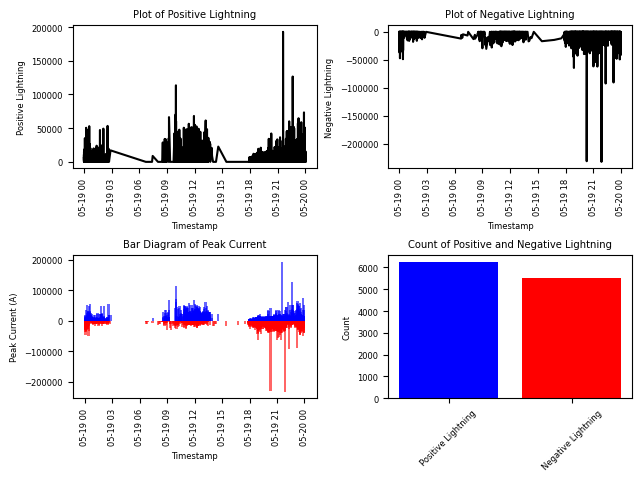

In [11]:
# font size
plt.rcParams.update({'font.size': 6}) # Only update the font size

fig, ax = plt.subplots(2, 2)
ax[0, 0].plot(df['timestamp'], df['peak_current_positive'], label='Positive Lightning', color='black')
ax[0, 0].set_xlabel('Timestamp')
ax[0, 0].set_ylabel('Positive Lightning')
ax[0, 0].set_title('Plot of Positive Lightning')
ax[0, 0].tick_params(axis='x', rotation=90)

ax[0, 1].plot(df['timestamp'], df['peak_current_negative'], label='Negative Lightning', color='black')
ax[0, 1].set_xlabel('Timestamp')
ax[0, 1].set_ylabel('Negative Lightning')
ax[0, 1].set_title('Plot of Negative Lightning')
ax[0, 1].tick_params(axis='x', rotation=90)


# Plotting bar diagram between positive and negative peak current
ax[1, 0].bar(df['timestamp'], df['peak_current_positive'], label='Positive Peak Current', color='blue', width=0.01, alpha=0.6)
ax[1, 0].bar(df['timestamp'], df['peak_current_negative'], label='Negative Peak Current', color='red', width=0.01, alpha=0.6)

ax[1, 0].set_xlabel('Timestamp')
ax[1, 0].set_ylabel('Peak Current (A)')
ax[1, 0].set_title('Bar Diagram of Peak Current')
ax[1, 0].tick_params(axis='x', rotation=90)

ax[1, 1].bar(['Positive Lightning', 'Negative Lightning'], [positive_count, negative_count], color=['blue', 'red'])
ax[1, 1].set_ylabel('Count')
ax[1, 1].set_title('Count of Positive and Negative Lightning')
ax[1, 1].set_xticklabels(['Positive Lightning', 'Negative Lightning'], rotation=45)
# Adjust layout to prevent overlap
plt.subplots_adjust(hspace=0.4, wspace=0.4)

plt.tight_layout()
plt.show()

## Map the data over country using Geopandas

In [12]:
!pip install geopandas

In [13]:
import geopandas as gpd
import matplotlib.colors as colors
import matplotlib.cm as cm

/usr/local/lib/python3.11/dist-packages/pyogrio/geopandas.py:275: UserWarning: More than one layer found in 'gadm41_NPL_shp.zip': 'gadm41_NPL_0' (default), 'gadm41_NPL_1', 'gadm41_NPL_2', 'gadm41_NPL_3', 'gadm41_NPL_4'. Specify layer parameter to avoid this warning.
  result = read_func(
<ipython-input-18-98e28e205533>:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('seismic')  # or 'coolwarm', 'bwr'


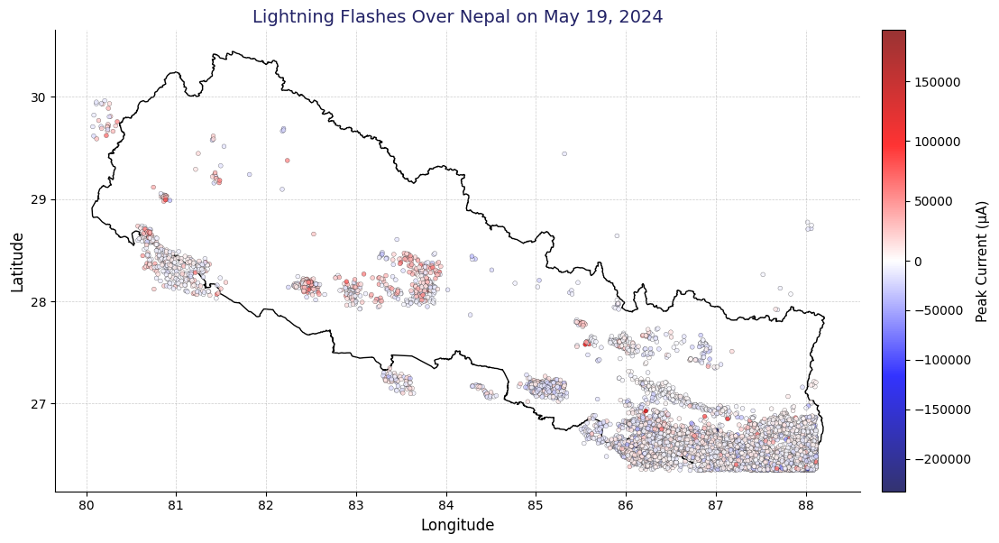

In [18]:
# Load Nepal shapefile
nepal_map = gpd.read_file("https://github.com/jsdhami/Lightning-Analysis/raw/refs/heads/main/gadm41_NPL_shp.zip")

# Clean and process
df = df.dropna(subset=['latitude', 'longitude'])
df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')
df = df.dropna(subset=['timestamp'])

# Create GeoDataFrame
geometry = [Point(xy) for xy in zip(df['longitude'], df['latitude'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Setup plot
fig, ax = plt.subplots(figsize=(13, 6))

# Plot Nepal boundary
nepal_map.plot(ax=ax, facecolor='white', edgecolor='black', linewidth=1)

# Diverging colormap centered at 0
vmin = gdf['peakcurrent'].min()
vmax = gdf['peakcurrent'].max()
norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
cmap = cm.get_cmap('seismic')  # or 'coolwarm', 'bwr'

# Scatter plot with diverging colormap
sc = ax.scatter(
    gdf.geometry.x, gdf.geometry.y,
    c=gdf['peakcurrent'],
    cmap=cmap,
    norm=norm,
    s=12,
    alpha=0.8,
    edgecolor='black',
    linewidth=0.2
)

# Add colorbar
cbar = plt.colorbar(sc, ax=ax, fraction=0.025, pad=0.02)
cbar.set_label('Peak Current (µA)', fontsize=11)
cbar.ax.tick_params(labelsize=10)

# Title and labels
ax.set_title(f"Lightning Flashes Over Nepal on May 19, 2024", fontsize=14, color='#222266')
ax.set_xlabel("Longitude", fontsize=12)
ax.set_ylabel("Latitude", fontsize=12)

# Aesthetic tweaks
ax.grid(True, linestyle='--', linewidth=0.5, color='gray', alpha=0.4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', labelsize=10)

plt.tight_layout()
plt.show()

## Plot Data over Nepal Map

In [20]:
# Create base map centered on Nepal
m = folium.Map(location=[28.3, 84.0], zoom_start=7, tiles='CartoDB positron')

# Add each lightning point
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='red' if row['peakcurrent'] < 0 else 'blue',
        fill=True,
        fill_opacity=0.4,
        popup=folium.Popup(f"Time: {row['timestamp']}<br>Peak Current: {row['peakcurrent']}<br>Types of Lightning: {row['type']}<br>Latitude:{row['latitude']}<br>Longitude:{row['longitude']}<br>Number Sensors:{row['numbersensors']} ", max_width=300)
    ).add_to(m)

m